Please upload an image file (e.g., jpg, png):


Saving rgb_dog.jpg to rgb_dog.jpg
Output saved as rotated_45_degrees.jpg


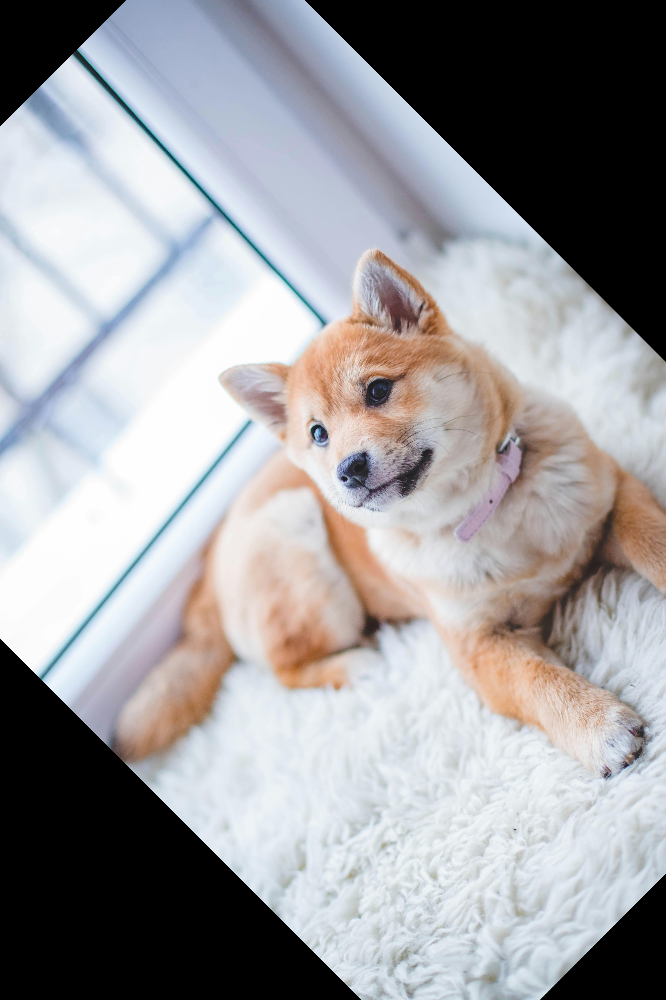

Output saved as rotated_90_degrees.jpg


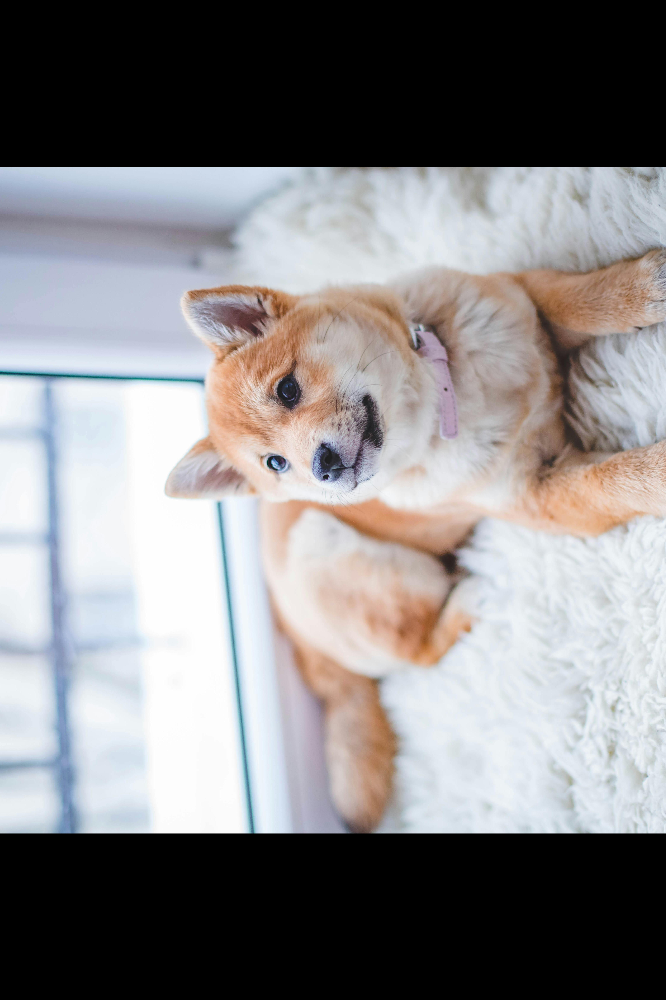

In [1]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from google.colab import files
import io

def rotate_image(image, angle):
    """
    Rotate image by a specified angle (in degrees).
    """
    # Get image dimensions
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)

    # Compute rotation matrix
    M = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Perform rotation
    rotated = cv2.warpAffine(image, M, (w, h))
    return rotated

def main():
    # Prompt user to upload an image
    print("Please upload an image file (e.g., jpg, png):")
    uploaded = files.upload()

    # Check if an image was uploaded
    if not uploaded:
        raise FileNotFoundError("No image uploaded. Please upload an image file.")

    # Get the first uploaded file
    file_name = list(uploaded.keys())[0]
    image_data = uploaded[file_name]

    # Read the image from the uploaded data
    image = cv2.imdecode(np.frombuffer(image_data, np.uint8), cv2.IMREAD_COLOR)
    if image is None:
        raise FileNotFoundError("Failed to load the image. Ensure the file is a valid image format.")

    # Rotate image by 45 and 90 degrees
    angles = [45, 90]
    for angle in angles:
        result = rotate_image(image, angle)
        output_file = f'rotated_{angle}_degrees.jpg'
        cv2.imwrite(output_file, result)
        print(f"Output saved as {output_file}")
        cv2_imshow(result)

if __name__ == "__main__":
    main()